
# CYCLING DATA QUALITY

## (03a) Extrinsic analysis

## ADD - if intrinsic have not been run with settings used here, the comparison cannot be made - is relying on results from intrinsic

**Overview**

This notebook contrasts and compares the OSM data on cycling infrastructure for a given area with a reference data set. To run this analysis, a reference data set must be available for comparison. 

The analysis is based on comparing OSM data to the reference dataset and highlighting how and where they differ, not only comparing *how much* cycling infrastructure is mapped in the two datasets, but also comparing *how* the infrastructure is mapped (e.g., looking at differing network topology and structure).

While the analysis is based on a comparison, the analysis makes no a priori assumptions about which dataset is better. The same goes for the identified differences: the workflow does not lead to an automatic conclusion as to which data set is of better quality, but instead requires the user to interpret the meaning of the differences found, e.g., whether differing features are results of errors of omission or commission, and which dataset is more correct.

The goal is that the identified differences can be used by the user to both assess the quality of the OSM and the reference datasets, and to support the decision of which dataset should be used for further analysis, if any.

**For a correct interpretation of some of the metrics for spatial data quality, some familiarity with the area is necessary.**

**Sections:**

1. Load and process data
2. Data completeness
    - Network length
    - Network densities
        - Global network density
        - Local network density
        - Density of protected vs. unprotected infrastructure
3. Network structure
    - Alpha, beta, and gamma indices
    - Simplification outcomes
    - Number of nodes and edges per infrastructure length
    - Local edge to node ratio
4. Network topology
    - Dangling nodes
    - Under/overshoots
5. Network component analysis
    - Disconnected components
    - Component size distribution
    - Largest connected component
    - Edge number distribution
    - Number of components per grid cell
    - Component connectivity
6. Save Results

_________________________


## 1. Load and process data

In [1]:
import geopandas as gpd
import pandas as pd
import osmnx as ox
import yaml
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib import cm
import matplotlib as mpl
import contextily as cx
import json
import pickle
import folium
import numpy as np
from collections import Counter
import warnings

from src import evaluation_functions as eval_func
from src import graph_functions as graph_func
from src import plotting_functions as plot_func

# Read in dictionaries with settings
%run ../settings/yaml_variables.py
%run ../settings/plotting.py
%run ../settings/tiledict.py
%run ../settings/df_styler.py

# # Load data
%run ../settings/load_osmdata.py
%run ../settings/load_refdata.py
%run ../settings/load_results.py

warnings.filterwarnings('ignore')

OSM graphs loaded successfully!
OSM data loaded successfully!
Reference graphs loaded successfully!
Reference data loaded successfully!
Results from intrinsic analyses loaded successfully!


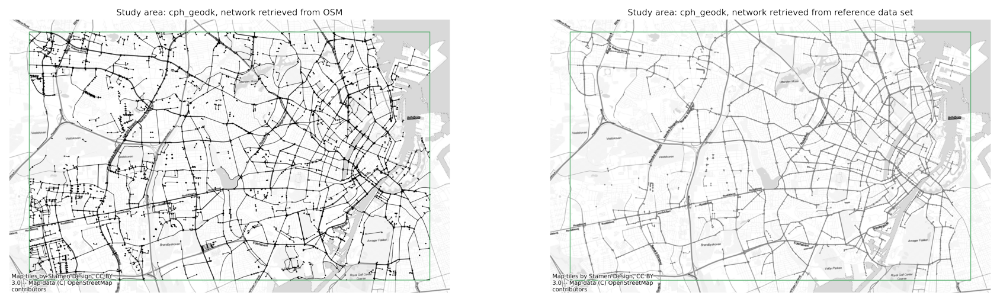

In [4]:
plot_saved_maps([osm_results_static_maps_fp + "area_network_OSM.png", ref_results_static_maps_fp + "area_network_REF.png"])

_________________

## 2. Data completeness

This section compares the OSM and reference datasets in terms of completeness.  

### Why?

The goal is to identify whether one dataset has more cycling infrastructure mapped than the other, and if so, whether those differences are concentrated in some areas. In the section below, first the total length of the infrastructure is compared for both data sets. Then, node and edge densities (i.e. the number of nodes/edges per square kilometer) compared both at global (study area) and at local (grid cell) level. Finally, density differences for protected and unprotected bicycle infrastructure are compared separately.

### How?

To account for differences in how cycling infrastructure has been mapped, the computation of network length and density is based on the infrastructure length, not the geometric length of the network edges. For example, a 100 meter long **bi**directional path (geometric length: 100m) contributes with 200 meters of cycling infrastructure (infrastructure length: 200m).

### What could it mean?

Density differences can point to incomplete data. For instance, if a grid cell has a significantly higher edge density in the OSM than in the reference data set, this indicates unmapped grid cell features in the reference data set. 


**Subsections:**

- Network length
- Network densities
    - Global network density
    - Local network density
    - Density of protected vs. unprotected infrastructure

### Network length

In [5]:
plot_func.compare_print_network_length(osm_edges_simplified.infrastructure_length.sum(), ref_edges_simplified.infrastructure_length.sum())

Length of the OSM data set: 1059.42 km
Length of the reference data set: 626.48 km


The OSM data set is 432.95 km longer than the reference data set.
The OSM data set is 40.87% longer than the reference data set.


### Network Densities

#### Global differences in network density

In [6]:
plot_func.print_network_densities(osm_intrinsic_results, 'OSM')
plot_func.print_network_densities(ref_intrinsic_results, 'reference')

In the OSM data, there are:
 - 5840.74 meters of cycling infrastructure per square km.
 - 27.06 nodes in the cycling network per square km.
 - 10.00 dangling nodes in the cycling network per square km.


In the reference data, there are:
 - 3453.85 meters of cycling infrastructure per square km.
 - 22.74 nodes in the cycling network per square km.
 - 4.80 dangling nodes in the cycling network per square km.




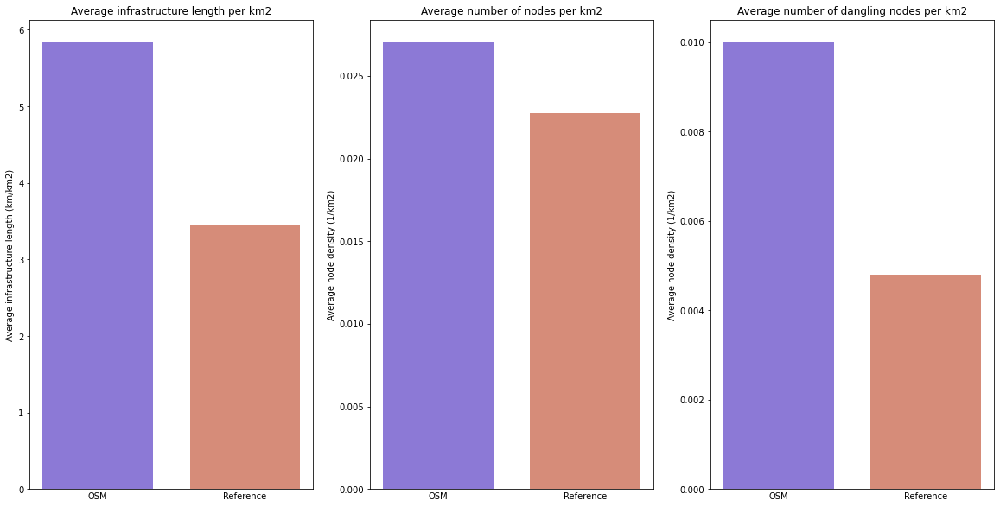

In [7]:
# PLOT GLOBAL DIFFERENCES 

bar_labels = ['OSM', 'Reference']
x_positions = [1,2]
bar_colors = [pdict["osm"],pdict["ref"]]

# Infrastructure length density
data = [(osm_intrinsic_results['network_density']['edge_density_m_sqkm']/1000,ref_intrinsic_results['network_density']['edge_density_m_sqkm']/1000),
(osm_intrinsic_results['network_density']['node_density_count_sqkm']/1000,ref_intrinsic_results['network_density']['node_density_count_sqkm']/1000),
(osm_intrinsic_results['network_density']['dangling_node_density_count_sqkm']/1000,ref_intrinsic_results['network_density']['dangling_node_density_count_sqkm']/1000)
]
y_label = ["Average infrastructure length (km/km2)","Average node density (1/km2)","Average node density (1/km2)"]
filepath = compare_results_plots_fp+"network_densities.png"
title = ['Average infrastructure length per km2',"Average number of nodes per km2","Average number of dangling nodes per km2"]

plot = plot_func.make_bar_subplots(subplot_data=data, nrows=1, ncols=3, bar_labels=bar_labels, y_label=y_label, x_positions=x_positions, title=title, bar_colors=bar_colors, filepath=filepath)

#### Local Network Density

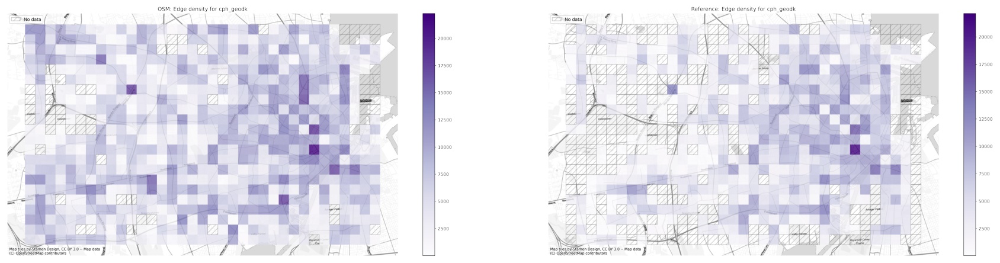

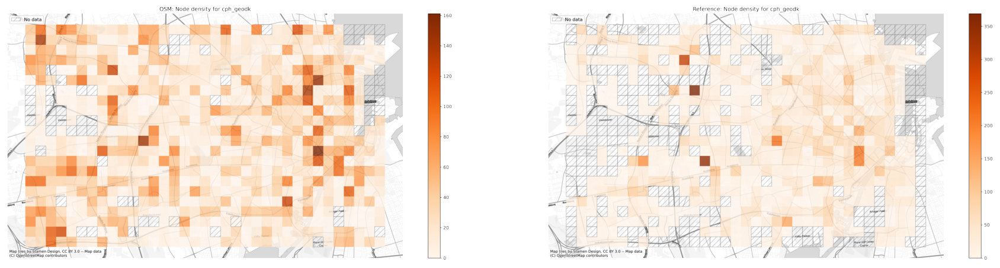

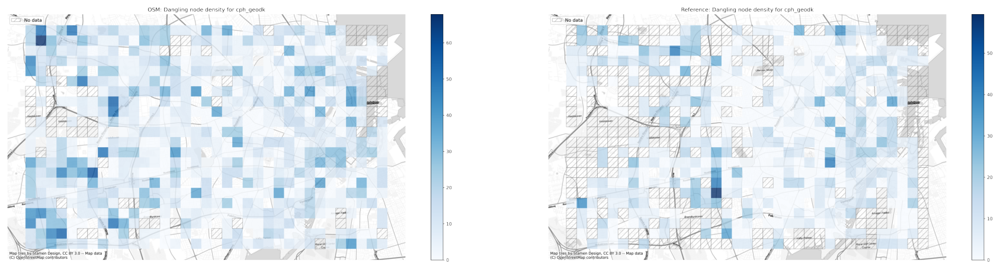

In [8]:
plot_saved_maps([osm_results_static_maps_fp + "density_edge_OSM.png", ref_results_static_maps_fp + "density_edge_REF.png"]) 

plot_saved_maps([osm_results_static_maps_fp + "density_node_OSM.png", ref_results_static_maps_fp + "density_node_REF.png"]) 

plot_saved_maps([osm_results_static_maps_fp + "density_danglingnode_OSM.png", ref_results_static_maps_fp + "density_danglingnode_REF.png"]) 


##### Local differences in network density

The densities in the OSM data set are taken as base line for comparison. Hence, positive values indicate that the OSM density of the infrastructure type is higher than the reference density; negative values indicate that the OSM density is lower than the reference density.

In [9]:
grid['edge_density_diff'] = grid.osm_edge_density.fillna(0) - grid.ref_edge_density.fillna(0)
grid['node_density_diff'] = grid.osm_node_density.fillna(0) - grid.ref_node_density.fillna(0)
grid['dangling_node_density_diff'] = grid.osm_dangling_node_density.fillna(0) - grid.ref_dangling_node_density.fillna(0)

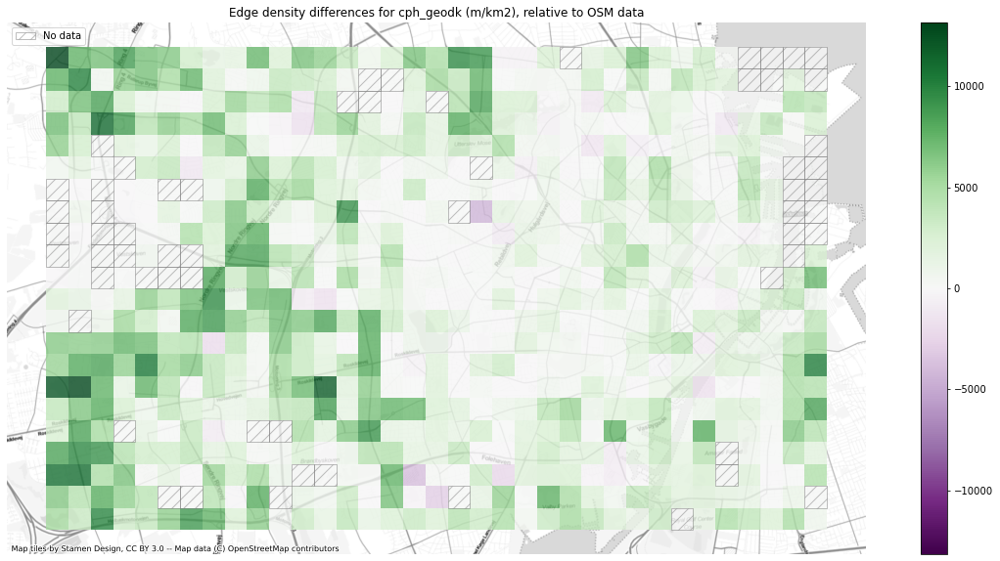

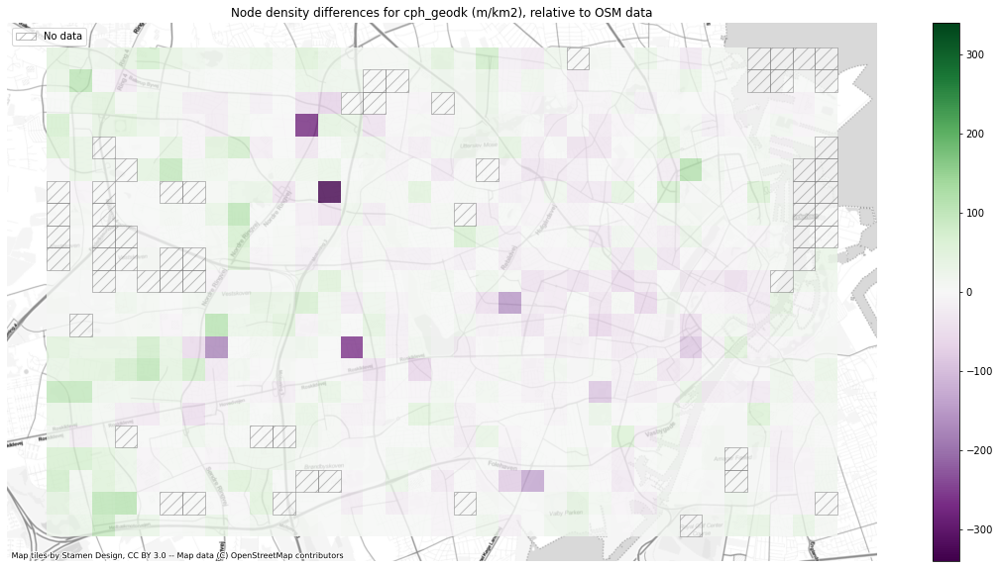

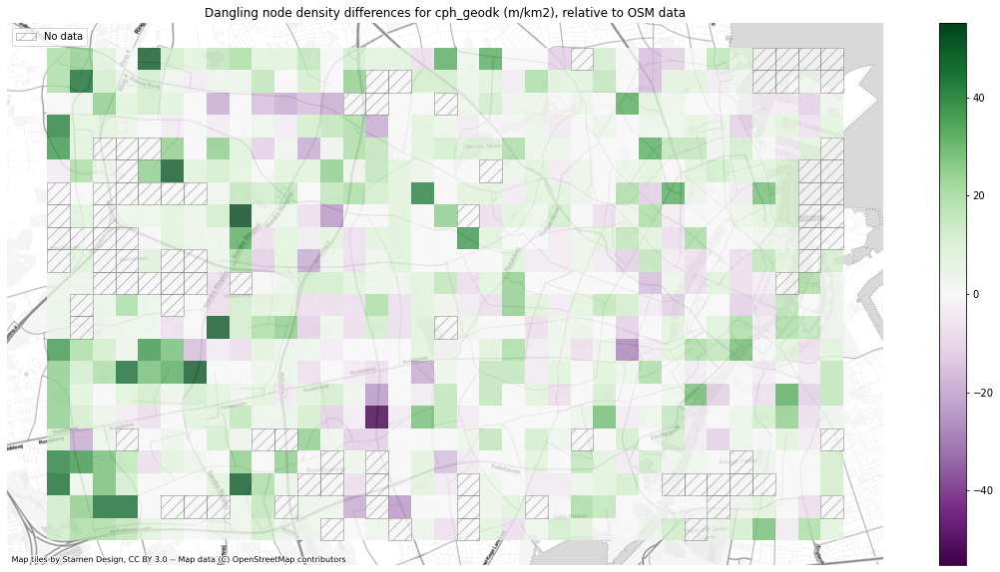

In [10]:
# Network density grid plots

plot_cols = ['edge_density_diff','node_density_diff','dangling_node_density_diff']
plot_titles = ['Edge density differences for ' + study_area + " (m/km2), relative to OSM data", 
    'Node density differences for ' + study_area + " (m/km2), relative to OSM data", 
   'Dangling node density differences for ' + study_area + " (m/km2), relative to OSM data"
    ]
filepaths = [compare_results_static_maps_fp + "edge_density_diff.png",
    compare_results_static_maps_fp + "node_density_diff.png", 
    compare_results_static_maps_fp + "dangling_node_density_diff.png"]

cmaps = [pdict["diff"]]*3

# Cols for no-data plots
no_data_cols = [("osm_edge_density","ref_edge_density"),("osm_node_density","ref_node_density"),("osm_dangling_node_density","ref_dangling_node_density")]

cblim_edge = max(abs(min(grid["edge_density_diff"].fillna(value=0))), max(grid["edge_density_diff"].fillna(value=0)))

cblim_node = max(abs(min(grid["node_density_diff"].fillna(value=0))), max(grid["node_density_diff"].fillna(value=0)))

cblim_d_node = max(abs(min(grid["dangling_node_density_diff"].fillna(value=0))), max(grid["dangling_node_density_diff"].fillna(value=0)))

norm_min = [-cblim_edge, -cblim_node, -cblim_d_node]
norm_max = [cblim_edge, cblim_node, cblim_d_node]

plot_func.plot_grid_results(grid=grid, plot_cols=plot_cols, plot_titles=plot_titles, filepaths=filepaths, 
cmaps=cmaps, alpha=pdict["alpha_grid"],cx_tile=cx_tile_2,no_data_cols=no_data_cols,use_norm=True,norm_min=norm_min,norm_max=norm_max)


#### Differences in density between protected/unprotected cycling infrastructure

##### Global Network Density for Protected/Unprocected Infrastructure

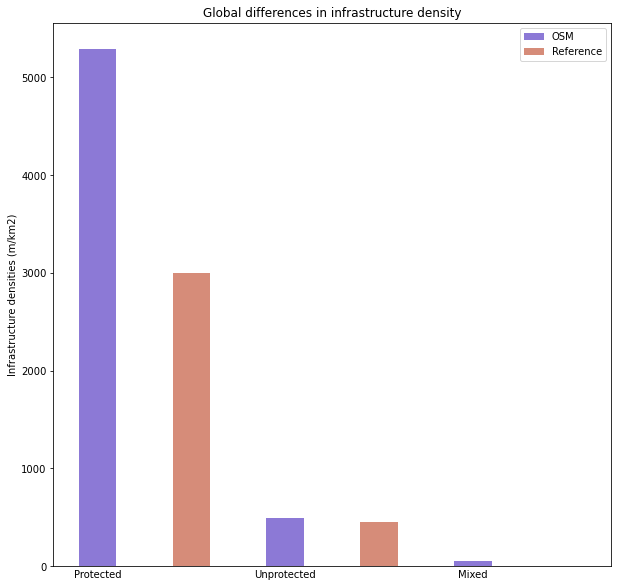

In [11]:
# PLOT GLOBAL DIFFERENCES 
data_labels = ['protected_density','unprotected_density','mixed_density']
legend_labels = ['OSM','Reference']
data_osm = [osm_intrinsic_results['network_density'][label+'_m_sqkm'] for label in data_labels]
data_ref = [ref_intrinsic_results['network_density'][label+'_m_sqkm'] for label in data_labels]
bar_colors = [pdict["osm"],pdict["ref"]]
title = "Global differences in infrastructure density"

x_labels = ['Protected', 'Unprotected', 'Mixed']
x_axis = [np.arange(len(x_labels))*2,np.arange(len(x_labels))*2+1]
x_ticks = x_axis[0]

y_label = "Infrastructure densities (m/km2)"

filepath = compare_results_plots_fp + "infrastructure_type_density_diff.png"

fig = plot_func.make_bar_plot_side(x_axis=x_axis, data_osm=data_osm, data_ref=data_ref, bar_colors=bar_colors, legend_labels=legend_labels, title=title, x_ticks=x_ticks, x_labels=x_labels, y_label=y_label,filepath=filepath)

#### Local differences in network density for protected vs. unprotected infrastructure

The densities in the OSM data set are taken as base line for comparison. Hence, positive values indicate that the OSM density of the infrastructure type is higher than the reference density; negative values indicate that the OSM density is lower than the reference density.

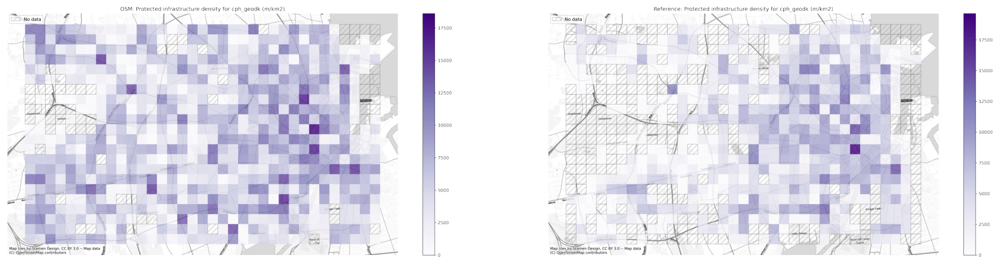

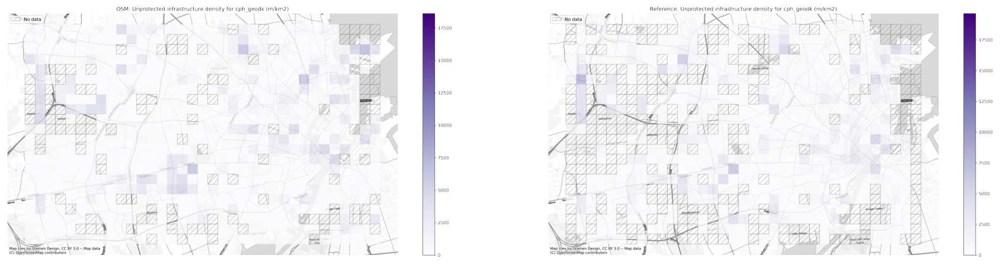

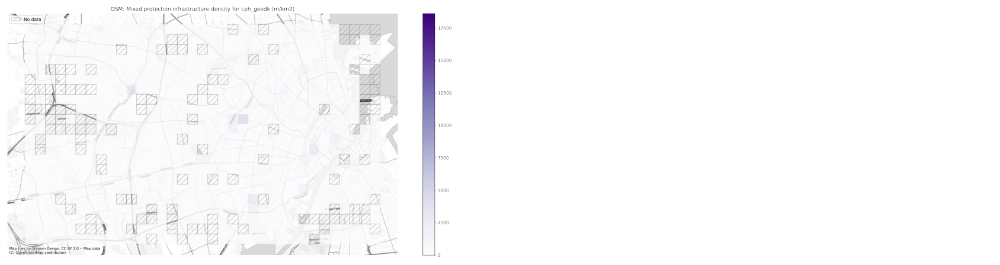

In [12]:
plot_saved_maps([osm_results_static_maps_fp + "density_protected_OSM.png", ref_results_static_maps_fp + "density_protected_REF.png"]) 

plot_saved_maps([osm_results_static_maps_fp + "density_unprotected_OSM.png", ref_results_static_maps_fp + "density_unprotected_REF.png"])

if 'ref_mixed_density' in grid.columns:

    plot_saved_maps([osm_results_static_maps_fp + "density_mixed_OSM.png", ref_results_static_maps_fp + "density_mixed_REF.png"])

else:
    plot_saved_maps([osm_results_static_maps_fp + "density_mixed_OSM.png"]*2,alpha=[1,0]) 

In [13]:
# In case no infrastructure with mixed protected/unprotected exist

if 'osm_mixed_density' not in grid.columns:
    print('No streets mapped as mixed protected/unprotected in OSM data.')
    grid['osm_mixed_density'] = 0

if 'ref_mixed_density' not in grid.columns:
    print('No streets mapped as mixed protected/unprotected in reference data.')
    grid['ref_mixed_density'] = 0

grid['protected_density_diff'] = grid.osm_protected_density.fillna(0) - grid.ref_protected_density.fillna(0)
grid['unprotected_density_diff'] = grid.osm_unprotected_density.fillna(0) - grid.ref_unprotected_density.fillna(0)
grid['mixed_density_diff'] = grid.osm_mixed_density.fillna(0) - grid.ref_mixed_density.fillna(0)

No streets mapped as mixed protected/unprotected in reference data.


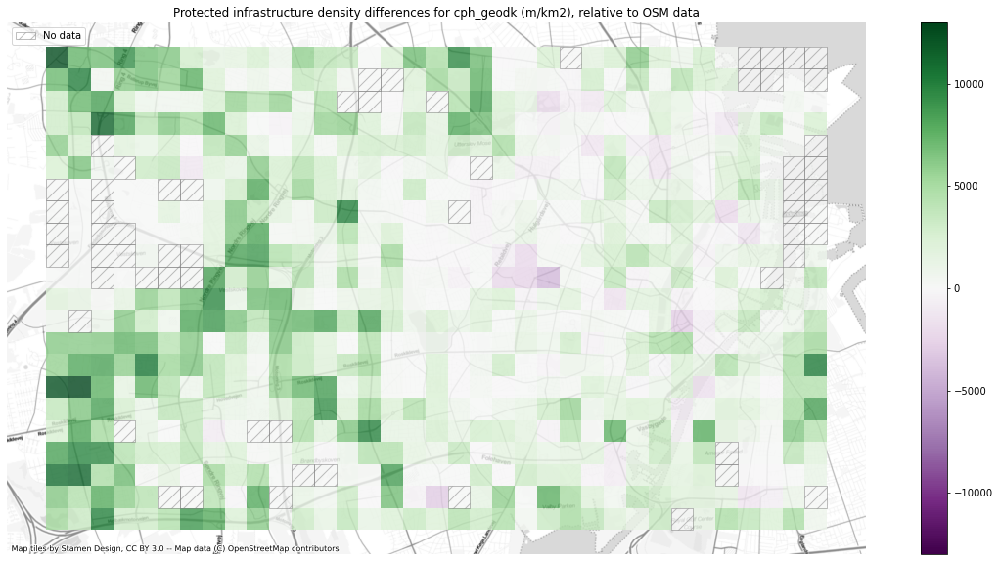

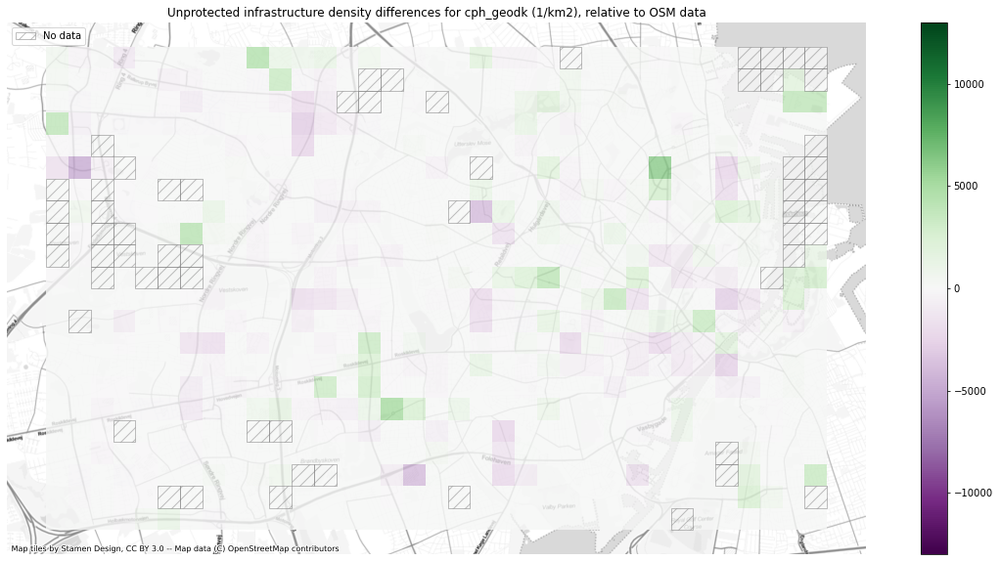

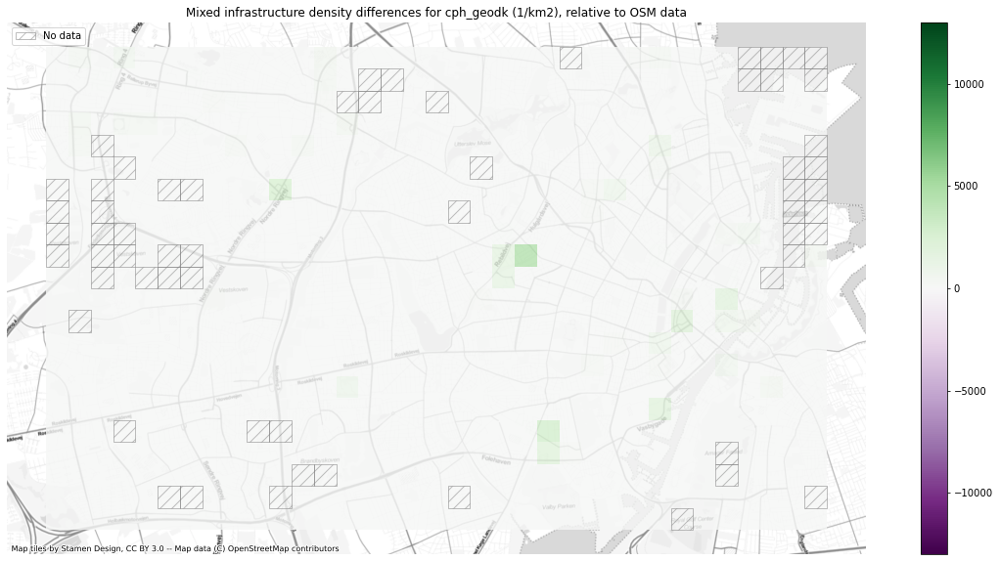

In [14]:
# Infrastructure type density grid plots

plot_cols = ["protected_density_diff", "unprotected_density_diff","mixed_density_diff"]
plot_cols = [c for c in plot_cols if c in grid.columns]
plot_titles = ["Protected infrastructure density differences for " + study_area + " (m/km2), relative to OSM data", 
    "Unprotected infrastructure density differences for " + study_area + " (1/km2), relative to OSM data",
    "Mixed infrastructure density differences for " + study_area + " (1/km2), relative to OSM data"]

filepaths = [compare_results_static_maps_fp + "protected_density_diff.png", compare_results_static_maps_fp + "unprotected_density_diff.png",compare_results_static_maps_fp + "mixed_density_diff.png"]

cmaps = [pdict["diff"]]*len(plot_cols)

# Cols for no-data plots
no_data_cols = [("osm_edge_density","ref_edge_density"),("osm_edge_density","ref_edge_density"),("osm_edge_density","ref_edge_density")]

# Create symmetrical color range around zero
cblim = max(abs(min(grid[plot_cols].fillna(value=0).min())), max(grid[plot_cols].fillna(value=0).max()))

norm_min = [-cblim]*len(plot_cols)
norm_max = [cblim]*len(plot_cols)

plot_func.plot_grid_results(grid=grid, plot_cols=plot_cols, plot_titles=plot_titles, filepaths=filepaths, 
cmaps=cmaps, alpha=pdict["alpha_grid"],cx_tile=cx_tile_2,no_data_cols=no_data_cols,use_norm=True,norm_min=norm_min,norm_max=norm_max)

___________________

## 3. Network structure

After having compared data completeness, i.e. *how much* infrastructure is mapped, in the section above, we now will focus on differences in network *structure*, which can give some information about *how* the infrastructure is mapped in both data sets. 

**Subsections:**

- Alpha, beta and gamma indices
- Simplification outcomes
- Number of nodes and edges per infrastructure length
- Local node/edge ratio

In each of the subsections, we compute the corresponding metrics for both data sets and then contrast the outcomes to visualize differences.

### Alpha, beta & gamma indices

In this subsection, we compute and contrast the three aggregated network metrics alpha, beta and gamma.

#### Why?

While no conclusion can be made about data quality based on any of the three metrics by itself, a comparison of the metrics for the two data sets can indicate differences in network topology, and hence differences in infrastructure mapping.

#### How?

All three indices are computed with `eval_func.compute_alpha_beta_gamma`.

The **alpha** value is the ratio of actual to possible cycles in the network. 

The **beta** value is the ratio of edges to nodes in the network. 

The **gamma** value is the ratio of actual to possible edges in the network.

For all three indices, see [Ducruet and Rodrigue, 2020](https://transportgeography.org/contents/methods/graph-theory-measures-indices/). All three indices can be interpreted in respect to network connectivity: The higher the alpha value, the more cycles are present in the network; the higher the beta value, the higher the number of paths and thus the higher the complexity of the network; and the higher the gamma value, the fewer edges lie between any pair of nodes.

#### What could it mean?

These metrics do not say much about the data quality itself, nor are they useful for a topological comparison of networks of similar size. However, some conclusions can be made through a comparison. For example, if the indices are very similiar for the two networks, despite the networks e.g. having very different geometric lengths, this suggests that the data sets have been mapped in roughly the same way, but than one simply includes more features than the other. On the other hand, if the networks have roughly the same total geometric length, but the values from alpha, beta and gamma differ, this can be an indication that the structure and topology of the two datasets are fundamentally different.

In [155]:
osm_alpha, osm_beta, osm_gamma = eval_func.compute_alpha_beta_gamma(edges=osm_edges_simplified, nodes=osm_nodes_simplified, G= osm_graph_simplified, planar=True) # We assume network to be planar or approximately planar

print(f'Alpha for the simplified OSM network: {osm_alpha:.2f}')
print(f'Beta for the simplified OSM network: {osm_beta:.2f}')
print(f'Gamma for the simplified OSM network: {osm_gamma:.2f}')

print('\n')

ref_alpha, ref_beta, ref_gamma = eval_func.compute_alpha_beta_gamma(ref_edges_simplified, ref_nodes_simplified, ref_graph_simplified, planar=True) # We assume network to be planar or approximately planar

print(f'Alpha for the simplified reference network: {ref_alpha:.2f}')
print(f'Beta for the simplified reference network: {ref_beta:.2f}')
print(f'Gamma for the simplified reference network: {ref_gamma:.2f}')

Alpha for the simplified OSM network: 0.11
Beta for the simplified OSM network: 1.15
Gamma for the simplified OSM network: 0.38


Alpha for the simplified reference network: 0.10
Beta for the simplified reference network: 1.14
Gamma for the simplified reference network: 0.38


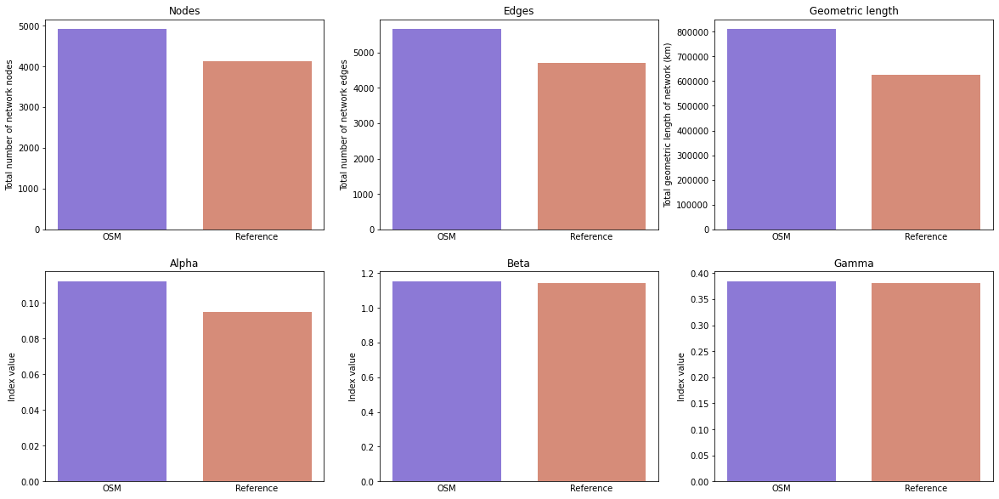

In [16]:
bar_labels = ['OSM', 'Reference']
x_positions = [1,2]
bar_colors = [pdict["osm"],pdict["ref"]]

data = [
    (len(osm_nodes_simplified),len(ref_nodes_simplified)),
    (len(osm_edges_simplified),len(ref_edges_simplified)),
    (osm_edges_simplified.geometry.length.sum(),ref_edges_simplified.geometry.length.sum()),
    (osm_alpha,ref_alpha),
    (osm_beta,ref_beta),
    (osm_gamma,ref_gamma)]
y_label = ["Total number of network nodes","Total number of network edges","Total geometric length of network (km)",'Index value','Index value','Index value']
title = ['Nodes','Edges','Geometric length','Alpha','Beta','Gamma']
filepath = compare_results_plots_fp+"alpha_beta_gamma.png"


plot = plot_func.make_bar_subplots(subplot_data=data, nrows=2, ncols=3, bar_labels=bar_labels, y_label=y_label, x_positions=x_positions, title=title, bar_colors=bar_colors, filepath=filepath)


#### Effect of network simplification

In [191]:
print(f"Simplifying the OSM network decreased the number of edges with {osm_intrinsic_results['simplification_outcome']['node_percent_diff']:.1f}%")
print(f"Simplifying the OSM network decreased the number of nodes with {osm_intrinsic_results['simplification_outcome']['node_percent_diff']:.1f}%")
print("\n")
print(f"Simplifying the reference network decreased the number of edges with {ref_intrinsic_results['simplification_outcome']['edge_percent_diff']:.1f}%")
print(f"Simplifying the reference network decreased the number of nodes with {ref_intrinsic_results['simplification_outcome']['node_percent_diff']:.1f}%")

Simplifying the OSM network decreased the number of edges with 84.3%
Simplifying the OSM network decreased the number of nodes with 84.3%


Simplifying the reference network decreased the number of edges with 91.2%
Simplifying the reference network decreased the number of nodes with 92.2%


In [18]:
# Plot node degree distributions

degree_sequence_before_osm = sorted((d for n, d in osm_graph.degree()), reverse=True)
degree_sequence_after_osm = sorted((d for n, d in osm_graph_simplified.degree()), reverse=True)

degree_sequence_before_ref = sorted((d for n, d in ref_graph.degree()), reverse=True)
degree_sequence_after_ref = sorted((d for n, d in ref_graph_simplified.degree()), reverse=True)

plot_func.print_node_sequence_diff(degree_sequence_before_osm, degree_sequence_after_osm, 'OSM')
plot_func.print_node_sequence_diff(degree_sequence_before_ref, degree_sequence_after_ref, 'reference')


Before the network simplification the OSM graph had:
- 1 node(s) with degree 7
- 1 node(s) with degree 6
- 27 node(s) with degree 5
- 716 node(s) with degree 4
- 1786 node(s) with degree 3
- 26880 node(s) with degree 2
- 1814 node(s) with degree 1


After the network simplification the OSM graph had:
- 1 node(s) with degree 7
- 1 node(s) with degree 6
- 27 node(s) with degree 5
- 716 node(s) with degree 4
- 1786 node(s) with degree 3
- 563 node(s) with degree 2
- 1814 node(s) with degree 1


Before the network simplification the reference graph had:
- 7 node(s) with degree 5
- 591 node(s) with degree 4
- 827 node(s) with degree 3
- 50705 node(s) with degree 2
- 870 node(s) with degree 1


After the network simplification the reference graph had:
- 7 node(s) with degree 5
- 591 node(s) with degree 4
- 827 node(s) with degree 3
- 1830 node(s) with degree 2
- 870 node(s) with degree 1




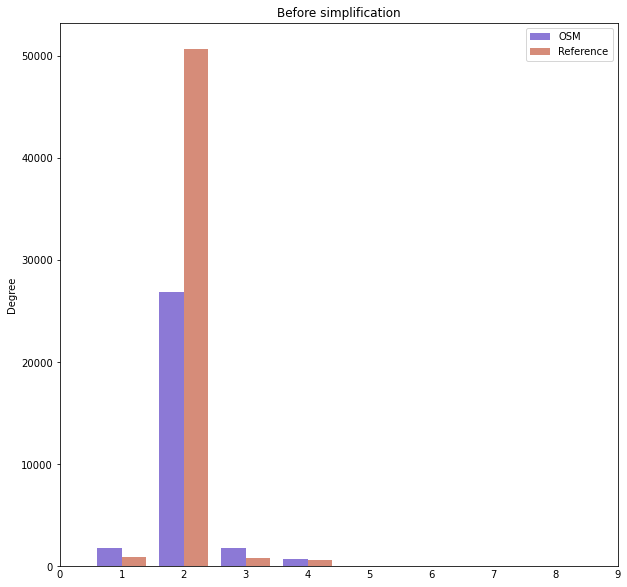

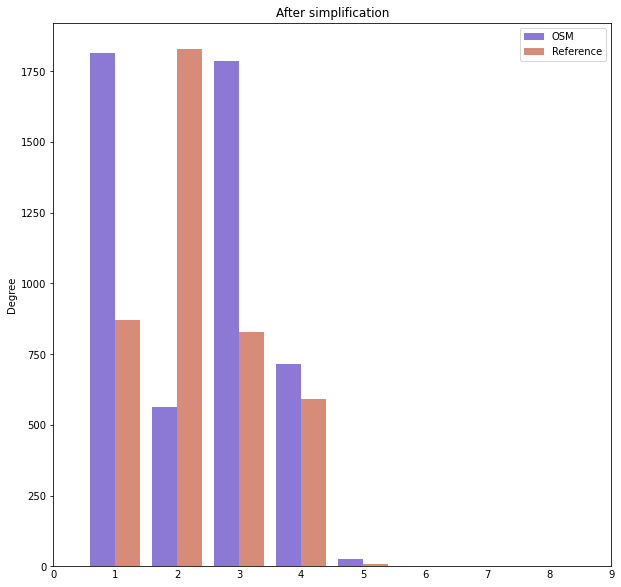

In [19]:
legend_labels = ['OSM','Reference']
bar_colors = [pdict["osm"],pdict["ref"]]
x_labels = [i for i in range(10)]
x_ticks = np.arange(len(x_labels))  
y_label = "Degree"

# Before
data_osm = np.unique(degree_sequence_before_osm, return_counts = True)[1]
data_ref = np.unique(degree_sequence_before_ref, return_counts = True)[1]
title = "Before simplification"
x_axis = [np.unique(degree_sequence_before_osm, return_counts = True)[0]-pdict["bar_single"]/2,np.unique(degree_sequence_before_ref, return_counts = True)[0]+pdict["bar_single"]/2]
filepath = compare_results_plots_fp + "degre_dist_before.png"

fig = plot_func.make_bar_plot_side(x_axis=x_axis, data_osm=data_osm, data_ref=data_ref, bar_colors=bar_colors, legend_labels=legend_labels, x_ticks=x_ticks, x_labels=x_labels, title=title, y_label=y_label,filepath=filepath, width=pdict["bar_single"])

# After
data_osm = np.unique(degree_sequence_after_osm, return_counts = True)[1]
data_ref = np.unique(degree_sequence_after_ref, return_counts = True)[1]
title = "After simplification"
x_axis = [np.unique(degree_sequence_after_osm, return_counts = True)[0]-pdict["bar_single"]/2,np.unique(degree_sequence_after_ref, return_counts = True)[0]+pdict["bar_single"]/2]
filepath = compare_results_plots_fp + "degree_dist_after.png"

fig = plot_func.make_bar_plot_side(x_axis=x_axis, data_osm=data_osm, data_ref=data_ref, bar_colors=bar_colors, legend_labels=legend_labels, x_ticks=x_ticks, x_labels=x_labels, title=title, y_label=y_label,filepath=filepath, width=pdict["bar_single"])


In [20]:
# Get df and dict of multiedges (removed by simplification routine)

# format: str to int
osm_edges_simplified['multiedge'] = osm_edges_simplified['multiedge'].astype(int)
ref_edges_simplified['multiedge'] = ref_edges_simplified['multiedge'].astype(int)

# get list of multiple edges
osm_multiple_edges = osm_edges_simplified[osm_edges_simplified['multiedge']>0].copy()
ref_multiple_edges = ref_edges_simplified[ref_edges_simplified['multiedge']>0].copy()

# save results to dict (for later json saving)
osm_multiple_edges_results = list(osm_multiple_edges.index)
ref_multiple_edges_results = list(ref_multiple_edges.index)

In [21]:
# Folium plot of multiple edges identified by simplification routine

if len(osm_multiple_edges_results) + len(ref_multiple_edges_results) > 0:

    myfgs = []

    osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
        gdf = osm_edges_simplified,
        mycolor = pdict["osm_base"],
        myweight = pdict["line_base"],
        nametag = 'OSM all edges',
        show_edges = True
    )

    myfgs.append(osm_edges_simplified_folium)

    ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
        gdf = ref_edges_simplified,
        mycolor = pdict["ref_base"],
        myweight = pdict["line_base"],
        nametag = 'Reference all edges',
        show_edges = True
    )

    myfgs.append(ref_edges_simplified_folium)

    if len(osm_multiple_edges_results) > 0:
        osm_multiple_edges_folium = plot_func.make_edgefeaturegroup(
            gdf = osm_multiple_edges,
            myweight = pdict["line_emp2"],
            mycolor = pdict["osm_emp"],
            nametag = 'OSM multiple edges',
            show_edges = True
        )
        myfgs.append(osm_multiple_edges_folium)
    else:
        print("No multiple edges in OSM data set")
    
    if len(ref_multiple_edges_results) > 0:
        ref_multiple_edges_folium = plot_func.make_edgefeaturegroup(
            gdf = ref_multiple_edges,
            myweight = pdict["line_emp2"],
            mycolor = pdict["ref_emp"],
            nametag = 'Reference multiple edges',
            show_edges = True
        )
        myfgs.append(ref_multiple_edges_folium)
    else:
        print("No multiple edges in reference data set")

    m = plot_func.make_foliumplot(
        feature_groups = myfgs,
        layers_dict = folium_layers,
        center_gdf = osm_nodes_simplified,
        center_crs = osm_nodes_simplified.crs
    )

    bounds = plot_func.compute_folium_bounds(osm_edges_simplified)
    m.fit_bounds(bounds)

    m.save(compare_results_inter_maps_fp+'multiple_edges_map_comparison.html')

    display(m)

else:
    print("No multiple edges found in OSM nor reference data set.")

No multiple edges found in OSM nor reference data set.


_____________________________

## 4. Network topology

In the following two subsections, dangling nodes and over- and undershoots are visualized and compared for both data sets.

**Subsections:**

- Dangling nodes
- Under/overshoots

### Dangling nodes

#### Dangling nodes - global

In [157]:
osm_dangling_nodes = gpd.read_file(osm_results_data_fp+"dangling_nodes.gpkg")
ref_dangling_nodes = gpd.read_file(ref_results_data_fp+"dangling_nodes.gpkg")

In [193]:
# Folium plot of dangling nodes

osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf = osm_edges_simplified,
    mycolor = pdict["osm_base"],
    myweight = pdict["line_base"],
    nametag = 'OSM edges',
    show_edges = True
)

osm_nodes_simplified_folium = plot_func.make_nodefeaturegroup(
    gdf = osm_nodes_simplified,
    mysize = pdict["mark_base"],
    mycolor = pdict["osm_base"],
    nametag = 'OSM all nodes',
    show_nodes = True
)

osm_dangling_nodes_folium = plot_func.make_nodefeaturegroup(
    gdf = osm_dangling_nodes,
    mysize = pdict["mark_emp"],
    mycolor = pdict["osm_emp"],
    nametag = 'OSM dangling nodes',
    show_nodes = True
)

ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf = ref_edges_simplified,
    mycolor = pdict["ref_base"],
    myweight = pdict["line_base"],
    nametag = 'Reference edges',
    show_edges = True
)

ref_nodes_simplified_folium = plot_func.make_nodefeaturegroup(
    gdf = ref_nodes_simplified,
    mysize = pdict["mark_base"],
    mycolor = pdict["ref_base"],
    nametag = 'Reference all nodes',
    show_nodes = True
)

ref_dangling_nodes_folium = plot_func.make_nodefeaturegroup(
    gdf = ref_dangling_nodes,
    mysize = pdict["mark_emp"],
    mycolor = pdict["ref_emp"],
    nametag = 'Reference dangling nodes',
    show_nodes = True
)

m = plot_func.make_foliumplot(
    feature_groups = [
        osm_edges_simplified_folium,
        osm_nodes_simplified_folium,
        osm_dangling_nodes_folium,        
        ref_edges_simplified_folium,
        ref_nodes_simplified_folium, 
        ref_dangling_nodes_folium],
    layers_dict = folium_layers,
    center_gdf = osm_nodes_simplified,
    center_crs = osm_nodes_simplified.crs
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)
m.save(compare_results_inter_maps_fp + 'danglingmap_comparison.html')

display(m)

#### Dangling nodes - local

In [25]:
# Compute pct diff relative to OSM
grid['dangling_nodes_diff_pct'] = np.round(100*(grid.count_osm_dangling_nodes - grid.count_ref_dangling_nodes)/grid.count_osm_dangling_nodes, 2)

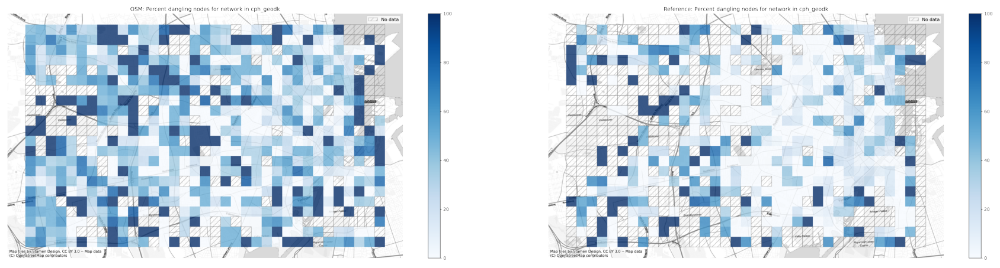

In [28]:
plot_saved_maps([osm_results_static_maps_fp + "pct_dangling_nodes.png", ref_results_static_maps_fp + "pct_dangling_nodes.png"])

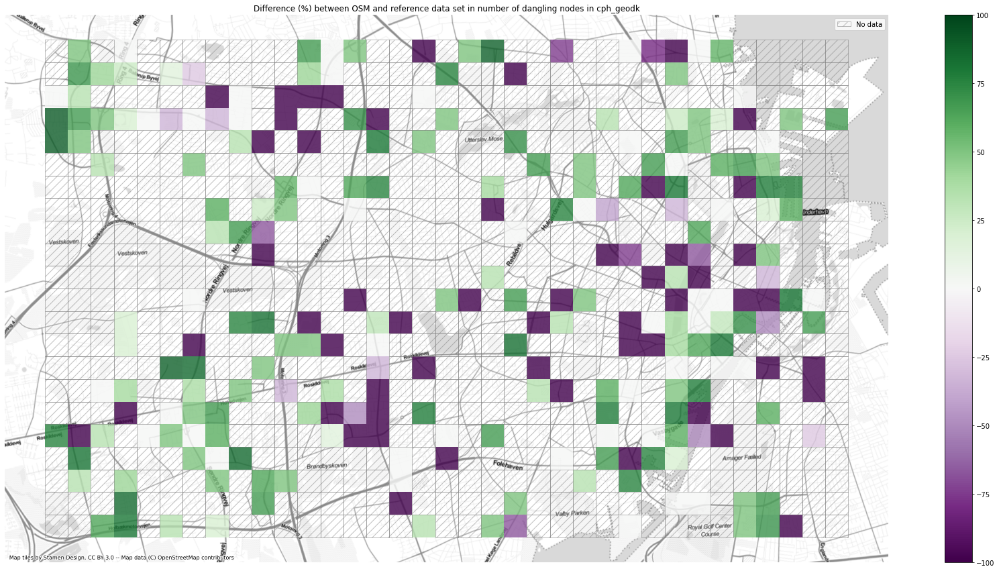

In [99]:
# Plot
# norm color bar
cbnorm_dang_diff = colors.Normalize(vmin=-100, vmax=100) # from -max to +max

fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

grid.plot(
    ax=ax,
    alpha=pdict["alpha_grid"],
    column="dangling_nodes_diff_pct",
    cmap = pdict["diff"], 
    legend =True,
    norm = cbnorm_dang_diff
)

# Add no data patches
grid[grid["dangling_nodes_diff_pct"].isnull()].plot(
    ax=ax, facecolor=pdict["nodata_face"], edgecolor=pdict["nodata_edge"], hatch=pdict["nodata_hatch"], alpha=pdict["alpha_nodata"]
)

ax.legend(handles=[nodata_patch], loc="upper right")

ax.set_title('Difference (%) between OSM and reference data set in number of dangling nodes in ' + study_area)
ax.set_axis_off()
cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

fig.savefig(compare_results_static_maps_fp + "dangling_nodes_pct_diff.png", dpi=pdict["dpi"])


### Under/overshoots 

Refer to intrinsic notebooks for explanations

In [32]:
# USER INPUT: LENGTH TOLERANCE FOR OVER- AND UNDERSHOOTS
length_tolerance_over = 3
length_tolerance_under = 3

for s in [length_tolerance_over, length_tolerance_under]:
    assert isinstance(s, int) or isinstance(s, float), print(
        "Settings must be integer or float values!"
    )

In [49]:
osm_overshoot_ids = pd.read_csv(osm_results_data_fp+f"overshoot_edges_{length_tolerance_over}.csv")['edge_id'].to_list()
osm_undershoot_ids = pd.read_csv(osm_results_data_fp+f"undershoot_nodes_{length_tolerance_under}.csv")['node_id'].to_list()

ref_overshoot_ids = pd.read_csv(ref_results_data_fp+f"overshoot_edges_{length_tolerance_over}.csv")['edge_id'].to_list()
ref_undershoot_ids = pd.read_csv(ref_results_data_fp+f"undershoot_nodes_{length_tolerance_under}.csv")['node_id'].to_list()

osm_overshoots = osm_edges_simplified.loc[osm_edges_simplified.edge_id.isin(osm_overshoot_ids)]
ref_overshoots = ref_edges_simplified.loc[ref_edges_simplified.edge_id.isin(ref_overshoot_ids)]
ref_undershoots = ref_nodes_simplified.loc[ref_nodes_simplified.nodeID.isin(ref_undershoot_ids)]
osm_undershoots = osm_nodes_simplified.loc[osm_nodes_simplified.osmid.isin(osm_undershoot_ids)]

In [58]:
### Folium plot over/undershoots

feature_groups = []

# OSM feature groups
osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf = osm_edges_simplified,
    mycolor = pdict["osm_base"],
    myweight = pdict["line_base"],
    nametag = 'OSM network',
    show_edges = True
)

feature_groups.append(osm_edges_simplified_folium)


if len(osm_overshoots) > 0:
    osm_overshoots_folium = plot_func.make_edgefeaturegroup(
        gdf = osm_overshoots,
        mycolor = pdict["osm_emp"],
        myweight = pdict["line_emp"],
        nametag = 'OSM overshoots',
        show_edges = True
    )

    feature_groups.append(osm_overshoots_folium)

if len(osm_undershoots) > 0:
    osm_undershoot_nodes_folium = plot_func.make_nodefeaturegroup(
        gdf = osm_undershoots,
        mysize = pdict["mark_emp"],
        mycolor = pdict["osm_emp2"],
        nametag = 'OSM undershoot nodes',
        show_nodes = True
    )

    feature_groups.append(osm_undershoot_nodes_folium)


# Reference feature groups
ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
    gdf = ref_edges_simplified,
    mycolor = pdict["ref_base"],
    myweight = pdict["line_base"],
    nametag = 'Reference network',
    show_edges = True
)

feature_groups.append(ref_edges_simplified_folium)

if len(ref_overshoots) > 0:
    ref_overshoots_folium = plot_func.make_edgefeaturegroup(
        gdf = ref_overshoots,
        mycolor = pdict["ref_emp"],
        myweight = pdict["line_emp"],
        nametag = 'Reference overshoots',
        show_edges = True
    )
    
    feature_groups.append(ref_overshoots_folium)

if len(ref_undershoots) > 0:
    
    ref_undershoot_nodes_folium = plot_func.make_nodefeaturegroup(
        gdf = ref_undershoots,
        mysize = pdict["mark_emp"],
        mycolor = pdict["ref_emp2"],
        nametag = 'Reference undershoot nodes',
        show_nodes = True
    )
    
    feature_groups.append(ref_undershoot_nodes_folium)

m = plot_func.make_foliumplot(
    feature_groups = feature_groups,
    layers_dict = folium_layers,
    center_gdf = osm_nodes_simplified,
    center_crs = osm_nodes_simplified.crs
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)

m.save(compare_results_inter_maps_fp+'overundershoots_comparison.html')

display(m)

__________________

## 5. Network component analysis

This section takes a close look at the network component characteristics for each of the two data sets.

**Subsections:**

- Disconnected components
- Component size distribution
- Largest connected component
- Edge number distribution
- Grid cells with no components
- Grid cells with more than one component
- Component connectivity

# Refer to intrinsic for explanations

**Number of disconnected components:**

In [60]:
print(f"The OSM network in the study area consists of {osm_intrinsic_results['component_analysis']['component_count']} unconnected components.")

print(f"The reference network in the study area consists of {ref_intrinsic_results['component_analysis']['component_count']} unconnected components.")

The OSM network in the study area consists of 353 unconnected components.
The reference network in the study area consists of 204 unconnected components.


**Component plots:**

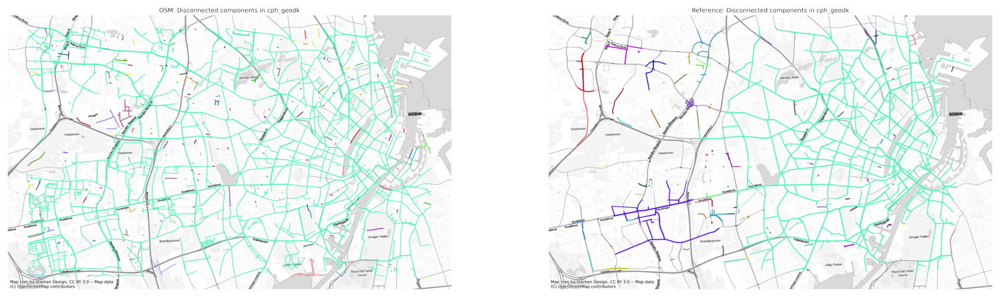

In [61]:
plot_saved_maps([osm_results_static_maps_fp + "all_components.png", ref_results_static_maps_fp + "all_components.png"]) 

**Distribution of network length per component:**

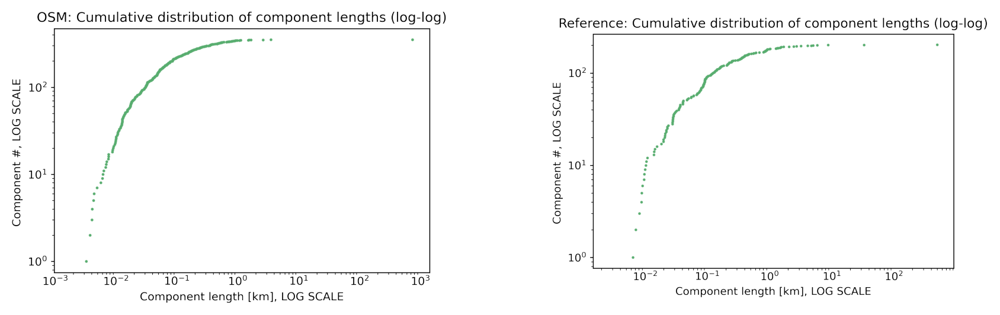

In [62]:
plot_saved_maps([osm_results_plots_fp + "component_length_distribution.png", ref_results_plots_fp + "component_length_distribution.png"]) 

**Largest connected component:**

In [70]:
# Read largest cc
osm_largest_cc = gpd.read_file(osm_results_data_fp+"largest_connected_component.gpkg")
ref_largest_cc = gpd.read_file(ref_results_data_fp+"largest_connected_component.gpkg")

print(f"The largest connected component in the OSM network contains {osm_intrinsic_results['component_analysis']['largest_cc_pct_size']:.2f} % of the network length.")
print(f"The largest connected component in the reference network contains {ref_intrinsic_results['component_analysis']['largest_cc_pct_size']:.2f} % of the network length.")

The largest connected component in the OSM network contains 92.36 % of the network length.
The largest connected component in the reference network contains 80.04 % of the network length.


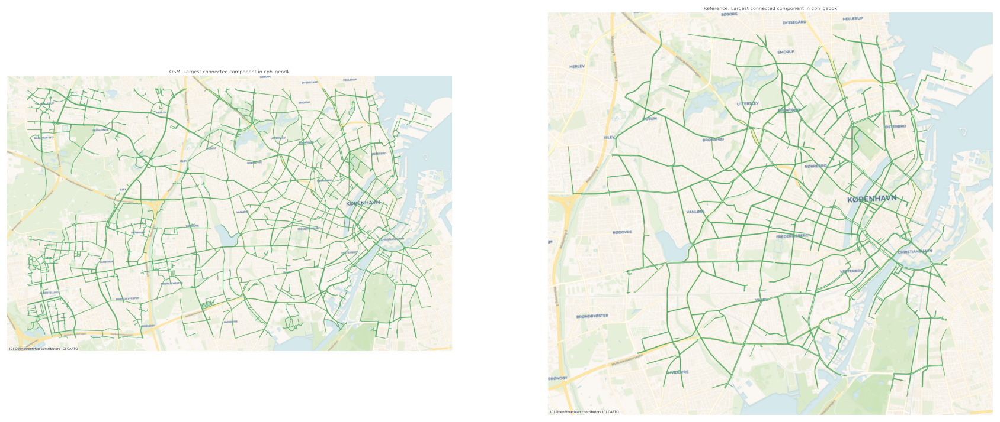

In [71]:
plot_saved_maps([osm_results_static_maps_fp + "largest_conn_comp.png", ref_results_static_maps_fp + "largest_conn_comp.png"]) 

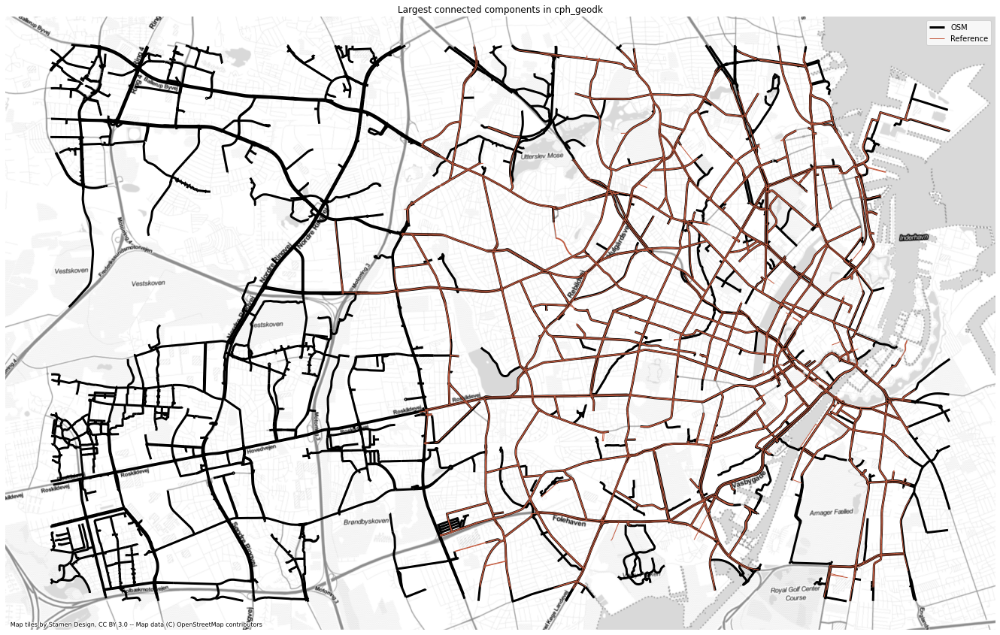

In [80]:
# Plot
fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

osm_largest_cc.plot(ax = ax, linewidth = 3, color = pdict["osm_base"], label = "OSM")
ref_largest_cc.plot(ax = ax, linewidth = 1, color = pdict["ref_emp"], label = "Reference")

ax.set_title(f'Largest connected components in {study_area}')
ax.set_axis_off()
ax.legend()
cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

fig.savefig(compare_results_static_maps_fp + "largest_cc_overlay.png", dpi=pdict["dpi"])


**Identifying potential missing links between unconnected components:**

In the map, the OSM and reference networks are shown in black and grey, respectively, while edges with potential missing links between ("component gaps") for OSM and the reference data set are shown in red and orange, respectively.

In [82]:
# DEFINE MAX BUFFER DISTANCE BETWEEN COMPONENTS CONSIDERED A GAP/MISSING LINK
component_min_distance = 10

assert isinstance(component_min_distance, int) or isinstance(
    component_min_distance, float
), print("Setting must be integer or float value!")

In [85]:
# Compute component gaps

osm_cg_edge_ids = pd.read_csv(osm_results_data_fp + f"component_gaps_edges_{component_min_distance}.csv")['edge_id'].to_list()
osm_component_gaps_edges = osm_edges_simplified.loc[osm_edges_simplified.edge_id.isin(osm_cg_edge_ids)]

ref_cg_edge_ids = pd.read_csv(ref_results_data_fp + f"component_gaps_edges_{component_min_distance}.csv")['edge_id'].to_list()
ref_component_gaps_edges = ref_edges_simplified.loc[ref_edges_simplified.edge_id.isin(ref_cg_edge_ids)]

osm_component_gaps = gpd.read_file(osm_results_data_fp + f"component_gaps_centroids_{component_min_distance}.gpkg")
ref_component_gaps = gpd.read_file(ref_results_data_fp + f"component_gaps_centroids_{component_min_distance}.gpkg")

In [96]:
# Folium plot of adjacent components

# The map highlights edges in different components with less than the specified threshold length between them

feature_groups = []

if len(osm_component_gaps_edges) > 0:

    # Feature groups for OSM
    osm_edges_simplified_folium = plot_func.make_edgefeaturegroup(
        gdf = osm_edges_simplified,
        mycolor = pdict["osm_base"],
        myweight = pdict["line_base"],
        nametag = 'OSM network',
        show_edges = True
    )

    osm_component_gaps_edges_folium = plot_func.make_edgefeaturegroup(
        gdf = osm_component_gaps_edges,
        mycolor = pdict["osm_emp"],
        myweight = pdict["line_emp"],
        nametag = 'OSM: Adjacent disconnected edges',
        show_edges = True
    )

    osm_component_gaps_folium = plot_func.make_markerfeaturegroup(
        gdf=osm_component_gaps,
        nametag="OSM: Component gaps",
        show_markers=True
    )

    feature_groups.extend([osm_edges_simplified_folium, osm_component_gaps_edges_folium, osm_component_gaps_folium])

# Feature groups for reference
if len(ref_component_gaps_edges) > 0:

    ref_edges_simplified_folium = plot_func.make_edgefeaturegroup(
        gdf = ref_edges_simplified,
        mycolor = pdict["ref_base"],
        myweight = pdict["line_base"],
        nametag = 'Reference network',
        show_edges = True
    )

    ref_component_gaps_edges_folium = plot_func.make_edgefeaturegroup(
        gdf = ref_component_gaps_edges,
        mycolor = pdict["ref_emp"],
        myweight = pdict["line_emp"],
        nametag = 'Reference: Adjacent disconnected edges',
        show_edges = True
    )

    ref_component_gaps_folium = plot_func.make_markerfeaturegroup(
        gdf=ref_component_gaps,
        nametag="Reference: Component gaps",
        show_markers=True
    )

    feature_groups.extend([ref_edges_simplified_folium,ref_component_gaps_edges_folium,ref_component_gaps_folium])

m = plot_func.make_foliumplot(
    feature_groups = feature_groups,
    layers_dict = folium_layers,
    center_gdf = osm_nodes_simplified,
    center_crs = osm_nodes_simplified.crs
)

bounds = plot_func.compute_folium_bounds(osm_nodes_simplified)
m.fit_bounds(bounds)
m.save(compare_results_inter_maps_fp+'component_gaps_comparison.html')

display(m)

### Number of components per grid cell

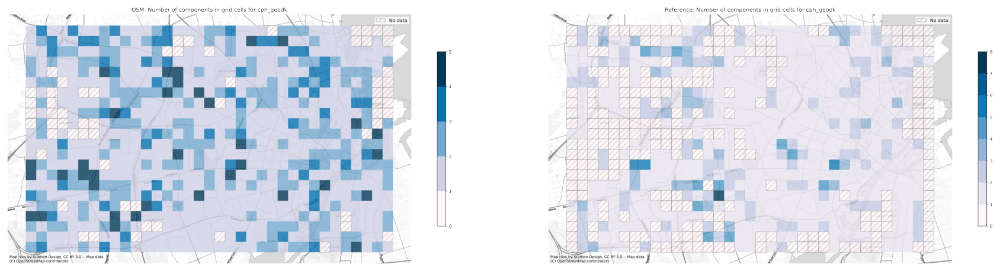

In [98]:
plot_saved_maps([osm_results_static_maps_fp + "number_of_components_in_grid_cells.png", ref_results_static_maps_fp + "number_of_components_in_grid_cells.png"]) 

### Component connectivity

Visualising differences between how many cells can be reached from each cell.
Positive values in the plot means that more cells can be reached from this particular cell using the OSM data, while negative values indicate a higher connectivity using the reference data set.

This is a crude measure for network connectivity, but has the benefit of being computationally cheap and thus able to highlight stark differences in network connectivity in very little time.

In [124]:
grid['cell_reach_pct_diff'] = grid['cells_reached_osm_pct'] - grid['cells_reached_ref_pct']

# @Ane: to discuss (alternative percentage computation)
# grid['cell_reach_diff_pct_2'] = None
# grid.loc[grid["cells_reached_osm"]>0, "cell_reach_diff_pct_2"] = grid[grid["cells_reached_osm"]>0].apply(lambda x: 
#      np.round( ((x.cells_reached_osm - x.cells_reached_ref) / x.cells_reached_osm)*100, 2) , 
#      axis = 1).min()

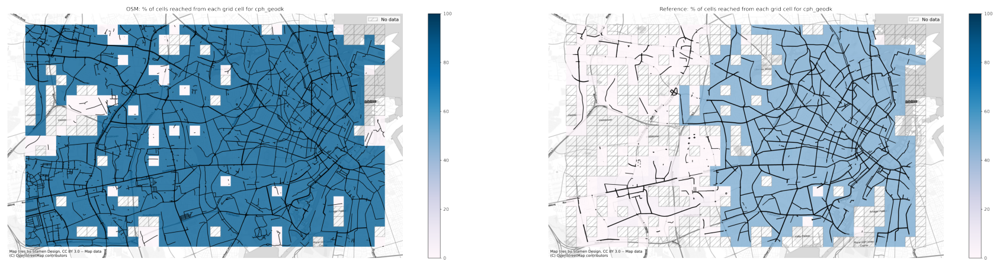

In [121]:
plot_saved_maps([osm_results_static_maps_fp + "percent_cells_reachable_grid.png", ref_results_static_maps_fp + "percent_cells_reachable_grid.png"]) 

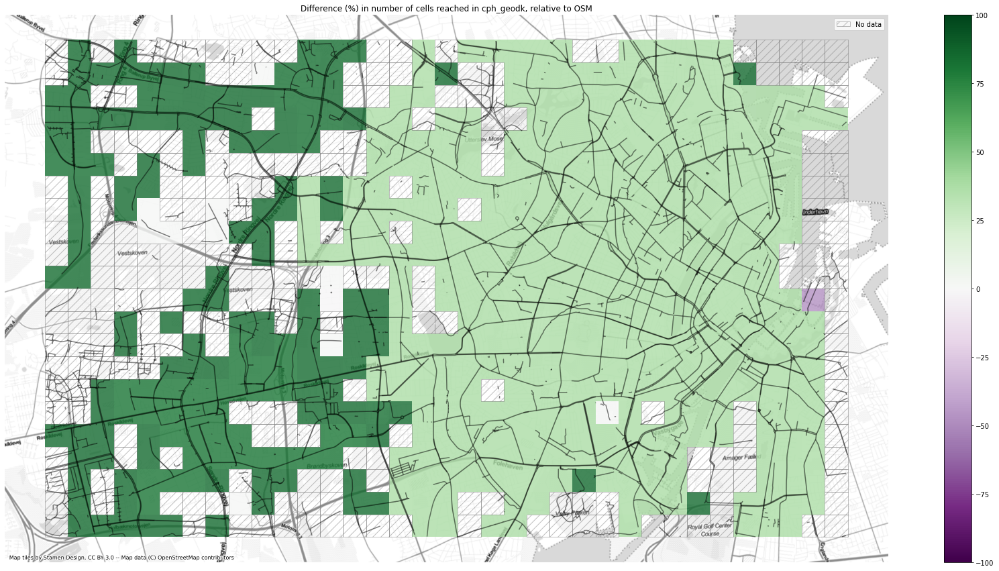

In [142]:
# Plot

# norm color bar
cbnorm_diff = colors.Normalize(vmin=-100, vmax=100)

fig, ax = plt.subplots(1, figsize=pdict["fsmap"])

grid.plot(
    ax=ax,
    alpha=pdict["alpha_grid"],
    column='cell_reach_pct_diff',
    cmap = pdict["diff"], 
    legend =True,
    norm = cbnorm_diff
)

# Add no data patches
grid[grid['cell_reach_pct_diff'].isnull()].plot(
    ax=ax, facecolor=pdict["nodata_face"], edgecolor=pdict["nodata_edge"], hatch=pdict["nodata_hatch"], alpha=pdict["alpha_nodata"]
)

osm_edges_simplified.plot(ax=ax, color=pdict["osm_base"], alpha=0.5)
#ref_edges_simplified.plot(ax=ax, color=pdict["osm_base"], alpha=0.5)

ax.legend(handles=[nodata_patch], loc="upper right")

ax.set_title(f'Difference (%) in number of cells reached in {study_area}, relative to OSM')
ax.set_axis_off()
cx.add_basemap(ax=ax, crs=study_crs, source=cx_tile_2)

fig.savefig(compare_results_static_maps_fp + "percent_cell_reached_diff.png", dpi=pdict["dpi"])


_________________

## 6. Summary

In [279]:
# Load results from intrinsic
osm_intrinsic_df = pd.read_csv(osm_results_data_fp+"intrinsic_summary_results.csv",index_col=0, names=['OSM'],header=0)
ref_intrinsic_df = pd.read_csv(ref_results_data_fp+"intrinsic_summary_results.csv",index_col=0, names=['Reference'],header=0)

# Drop rows from OSM results not available for reference
osm_intrinsic_df.drop(['Count of incompatible tag combinations','Count of missing intersection nodes'],axis=0, inplace=True)

# Save new results
osm_intrinsic_df.at['Alpha','OSM'] = osm_alpha
osm_intrinsic_df.at['Beta','OSM'] = osm_beta
osm_intrinsic_df.at['Gamma','OSM'] = osm_gamma

ref_intrinsic_df.at['Alpha','Reference'] = ref_alpha
ref_intrinsic_df.at['Beta','Reference'] = ref_beta
ref_intrinsic_df.at['Gamma','Reference'] = ref_gamma

# Combine
extrinsic_df = osm_intrinsic_df.join(ref_intrinsic_df)

assert len(extrinsic_df) == len(osm_intrinsic_df) == len(ref_intrinsic_df)

# Compute absolute difference
extrinsic_df['Difference'] = abs(extrinsic_df['OSM'] - extrinsic_df['Reference'])

# Compute pct difference
# TODO: Better way to compute pct diff?
extrinsic_df.loc[extrinsic_df[(extrinsic_df.OSM > 0) & (extrinsic_df.Reference > 0)].index,'Percent difference']  = (abs(extrinsic_df['OSM'] - extrinsic_df['Reference']) / ((extrinsic_df['OSM'] + extrinsic_df['Reference']) / 2))*100

In [ ]:
# TODO: style!

________________________

## 7. Save results

In [ ]:
extrinsic_df.to_csv(compare_results_data_fp + "extrinsic_summary_results.csv",index=True)

with open(compare_results_data_fp + f'grid_results_extrinsic_{study_area}.pickle', 'wb') as f:
    pickle.dump(grid, f)